### Preprocess

In [1]:
import pandas as pd
import numpy as np
import mylibrary as lib
import plotly.express as px
import plotly.graph_objs as go
import plotly.io as pio
import random
import copy
import matrixprofile as mp
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import stumpy

In [2]:
df, filename = lib.preprocess.upload.upload_csv()

In [3]:
df['DateTime'] = pd.to_datetime(df['DateTime'])
df = df.dropna()

In [4]:
dt1 = pd.to_datetime('2023-07-14 00:00:04')
dt2 = pd.to_datetime('2023-07-14 23:59:04')
df['DateTime'] = pd.to_datetime(df['DateTime'])
df = df[(df['DateTime'] >= dt1) & (df['DateTime'] <= dt2)]

In [5]:
df1 = df.copy() 
df1 = lib.preprocess.scale.apply_min_max_scale(df1)
df_resampled = df1.resample('2s', on='DateTime').mean().reset_index()

In [6]:
def smoothing(x, k):
    width = 1 / k

    for i in range(k):
        min_val = i * width
        max_val = (i + 1) * width

        if min_val <= x <= max_val:
            return min_val

    return "Invalid value"

def apply_smoothing_to_dataframe(df, k):
    result_df = df.copy()

    for column in result_df.columns:
        if column != 'DateTime':
            result_df[f'{column}_binned'] = result_df[column].apply(lambda x: smoothing(x, k))
            del result_df[column] 

    return result_df

In [7]:
k = 200
df_resampled = apply_smoothing_to_dataframe(df_resampled, k)

In [8]:
sensors = df_resampled.columns[1:]
sensors

Index(['Hid_Pomp_Balans_binned', 'Hid_Pomp_Motor_Rulman_binned',
       'Hid_emn_bas_act_binned'],
      dtype='object')

In [9]:
df1 = df_resampled.copy()
df1 = df1.dropna()

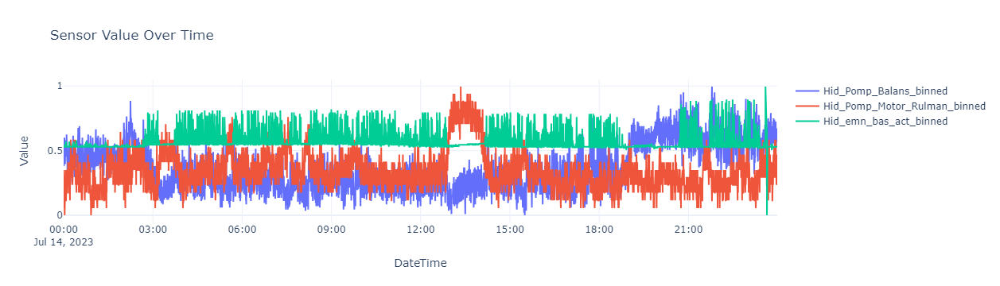

In [10]:
lib.plot.linechart.plot_line_chart(df1)

In [11]:
df_results = pd.DataFrame(columns=['data', 'noise', 'nsensors', 'anomaly count',  'wave len', 'window', 'precision', 'recall', 'anomaly_normal_ratio', 'noise direction'])

#### Fucntions

In [12]:
def plot_multi_mp(mps2, df2, discords2):
    fig, axs = plt.subplots(mps2.shape[0] * 2, sharex=True, gridspec_kw={'hspace': 0})

    for k, dim_name in enumerate(df2.columns[1:]):
        axs[k].set_ylabel(dim_name, fontsize='7', rotation = 0)
        axs[k].plot(df2[dim_name])
        axs[k].set_xlabel('Time', fontsize ='7')
    
        for idx in discords2[k]:
            axs[k].plot(idx, df2[dim_name].iloc[idx], 'ro', markersize=3) 
    
        axs[k + mps2.shape[0]].set_ylabel("MP {}".format(dim_name), fontsize='7', rotation = 0)
        axs[k + mps2.shape[0]].plot(mps2[k], c='orange')
        axs[k + mps2.shape[0]].set_xlabel('Time', fontsize ='7')
    
       
    plt.show()

In [13]:
# set1 is anomaly points set
# outliers_sets is list of predicted points sets
# anomaly_points is matrix
def union_window_multi(set1, outliers_sets, anomaly_points, window_size):
    union_set = set()
    majority_num = len(outliers_sets) // 2 + 1 
    
    for elem1 in set1:
        count = sum(1 for outlier_set in outliers_sets for elem2 in outlier_set if abs(elem1 - elem2) < window_size)
        if count >= majority_num:
            for arr in anomaly_points:
                if elem1 in arr:
                    union_set.add(tuple(arr))
                    break

    return union_set

In [14]:
# anomaly_points is [[],[],[]] matrix
# outliers is matrix
def get_metrics_multi(anomaly_points, outliers, window_size):
    
    flat_anomaly_points = [point for arr in anomaly_points for point in arr]
    set_a = set(flat_anomaly_points)
    outliers_sets = [set(arr) for arr in outliers]
    
    intersection = (union_window_multi(set_a, outliers_sets, anomaly_points, window_size))
    tp = sum(len(t) for t in intersection)
    
    precision = tp/len(outliers_sets[0])
    recall = tp/len(set_a)


    return precision, recall

In [15]:
from stumpy import core, config
config.STUMPY_EXCL_ZONE_DENOM = 2 

def get_results(df, anomaly_normal_ratio, anomaly_count, wave_length, noise, nsensors, df_results):
    df1 = df.copy()
    df1, anomaly_points = lib.preprocess.anomaly.apply_anomaly(df1, noise = noise, anomaly_normal_ratio = anomaly_normal_ratio, noise_direction = 'n', random_state = 300, wave = True, wave_length = wave_length, nsensors = nsensors)

    anomaly_points['Hid_emn_bas_act_binned'].append([42549, 42548, 42441, 42457, 42547, 42442, 42456, 42527, 42443,
                                42546, 42455, 42545, 42444, 42544, 42528, 42543, 42542, 42541,
                                42540, 42539, 42538, 42529, 42537, 42536, 42454, 42535, 42530,
                                42534, 42445, 42533, 42531, 42532, 42453, 42446, 42452, 42451,
                                42447, 42450, 42449, 42448])
    
   
    window = wave_length * 2  if wave_length * 2 > 20 else 20
   
    mps, indices = stumpy.mstump(df1[df1.columns[1:]], window, normalize = False, discords = True)

    anomaly_points = anomaly_points[next(iter(anomaly_points))]
    b = sum(len(arr) for arr in anomaly_points)
    discords = np.argpartition(mps, -int(b), axis=1)[:, -int(b):]

    plot_multi_mp(mps, df1, discords)

    precision, recall = get_metrics_multi(anomaly_points, discords, window)

    row = {'data': 77, 'noise': noise, 'nsensors': nsensors, 'anomaly count': anomaly_count,  
    'wave len': wave_length, 'window' : window, 'precision' : precision, 'recall' : recall, 
    'anomaly_normal_ratio' : anomaly_normal_ratio, 'noise direction' : 'n'}
    df_results = pd.concat([df_results, pd.DataFrame([row])], ignore_index=True)
    return df_results

### MP

In [16]:
wave_lengths = [1, 15, 60]
noises = [0.5, 0.25, 0.1]
anomaly_counts = [1, 5, 10]
anomaly_normal_ratios = {1: 0.000025, 5: 0.00013, 10: 0.00024}
nsensors = [1, 2, 3]

Hid_emn_bas_act_binned
1 ANOMALIES


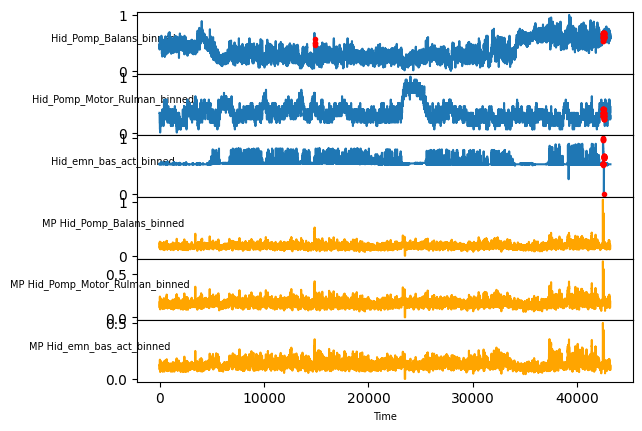

Hid_emn_bas_act_binned
5 ANOMALIES


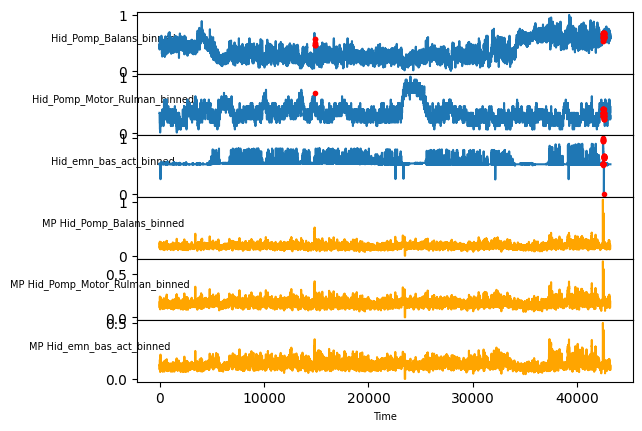

Hid_emn_bas_act_binned
10 ANOMALIES


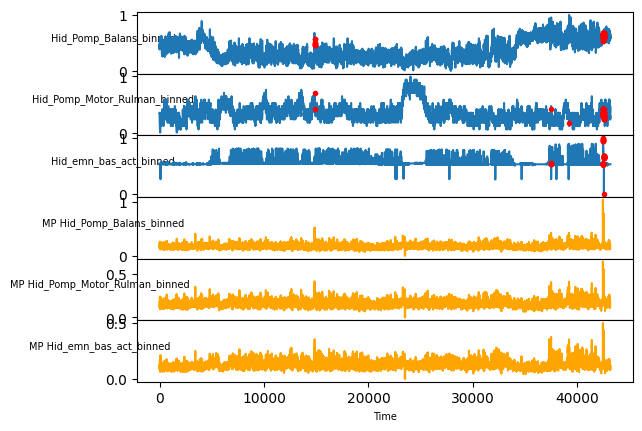

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


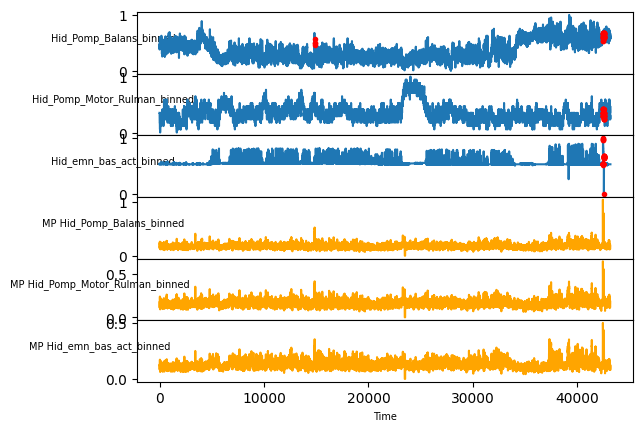

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


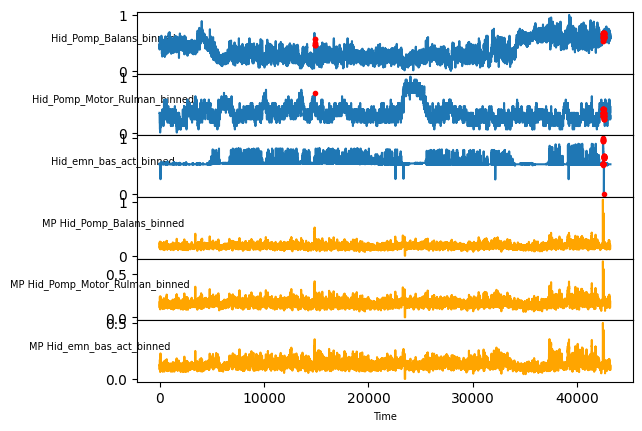

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


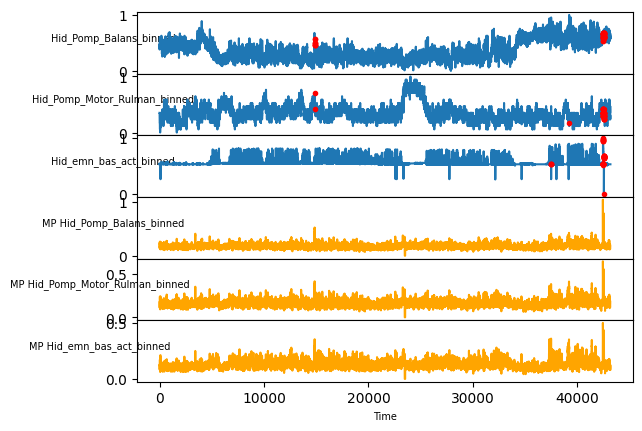

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


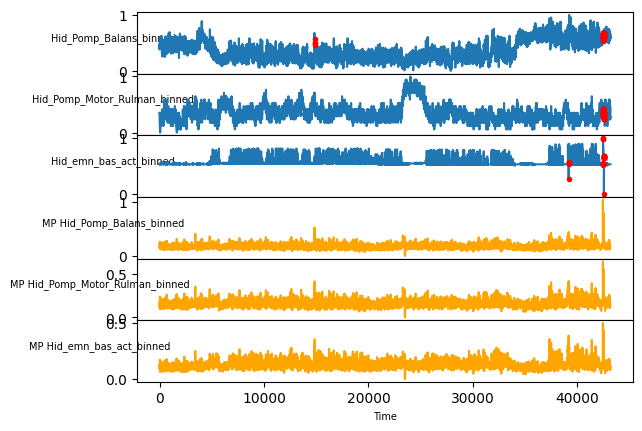

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


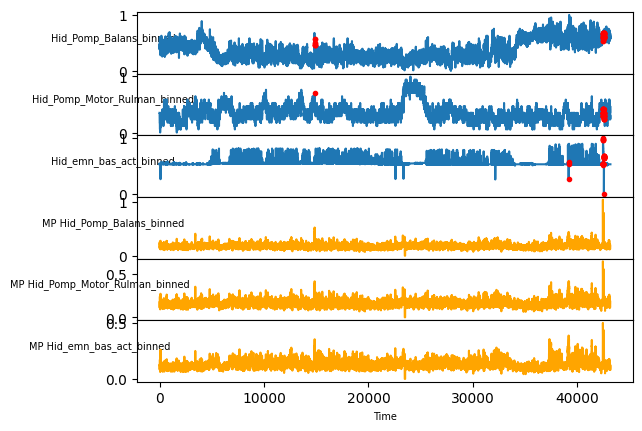

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


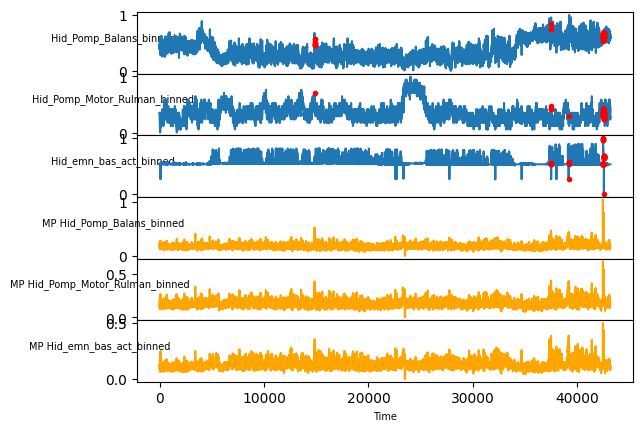

Hid_emn_bas_act_binned
1 ANOMALIES


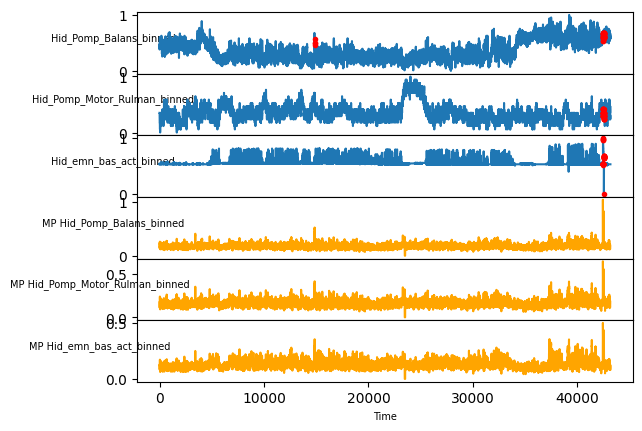

Hid_emn_bas_act_binned
5 ANOMALIES


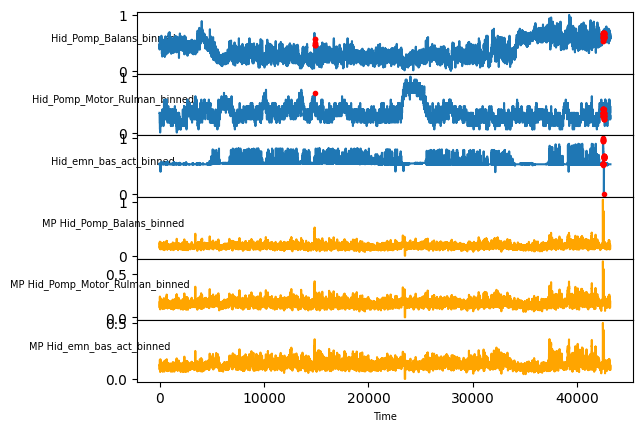

Hid_emn_bas_act_binned
10 ANOMALIES


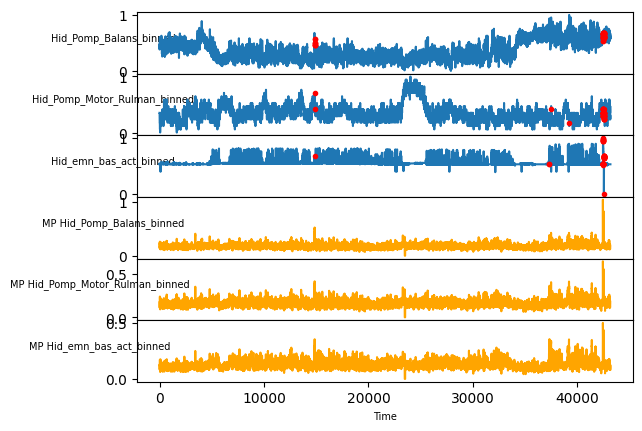

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


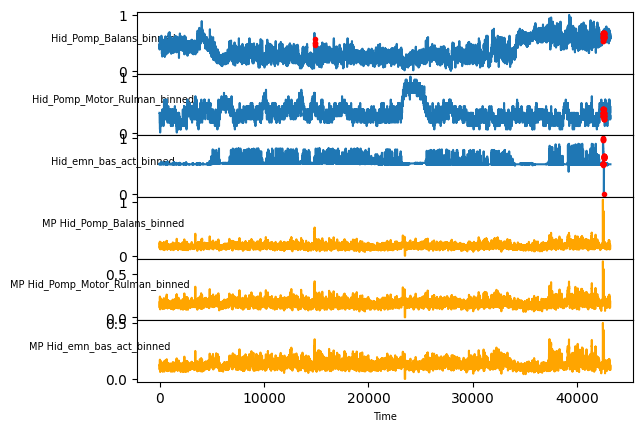

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


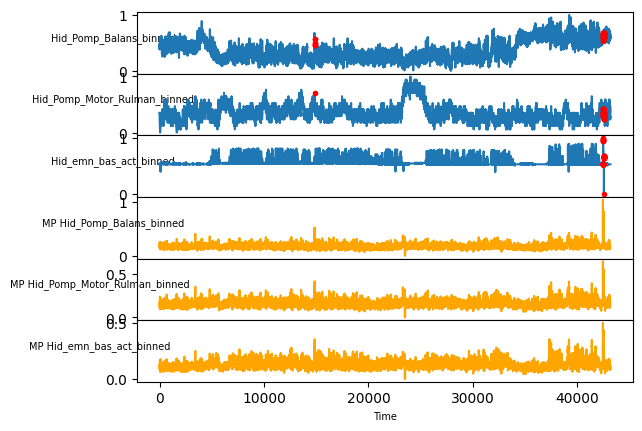

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


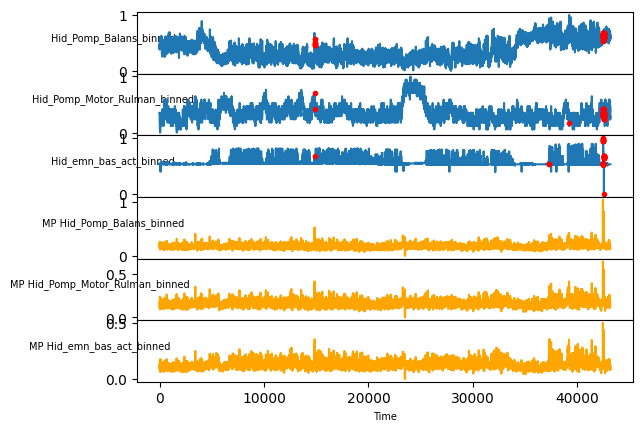

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


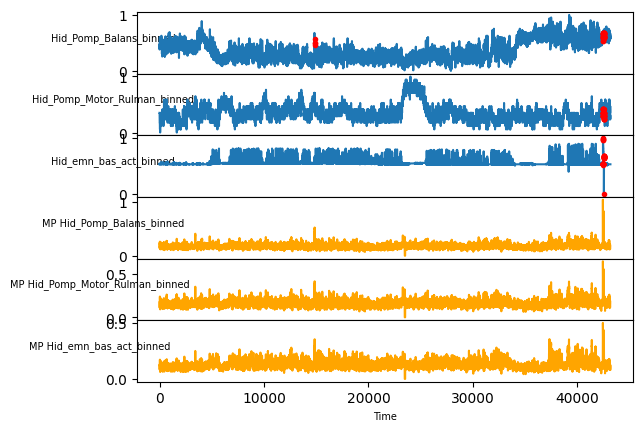

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


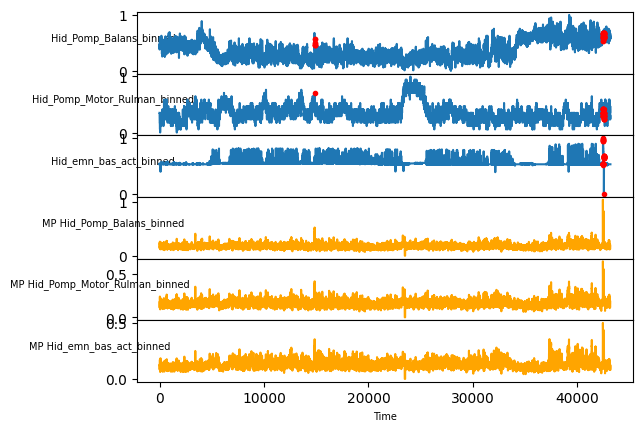

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


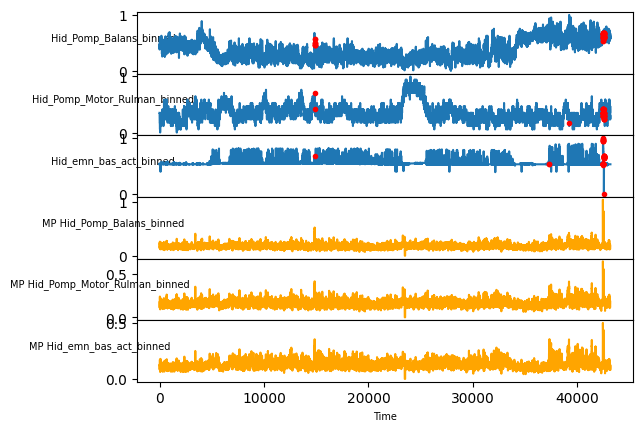

Hid_emn_bas_act_binned
1 ANOMALIES


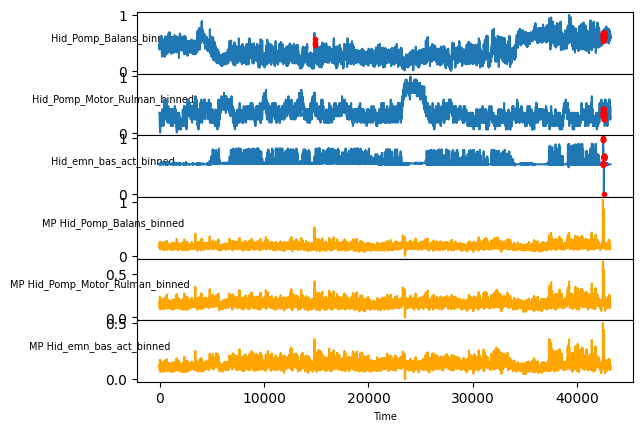

Hid_emn_bas_act_binned
5 ANOMALIES


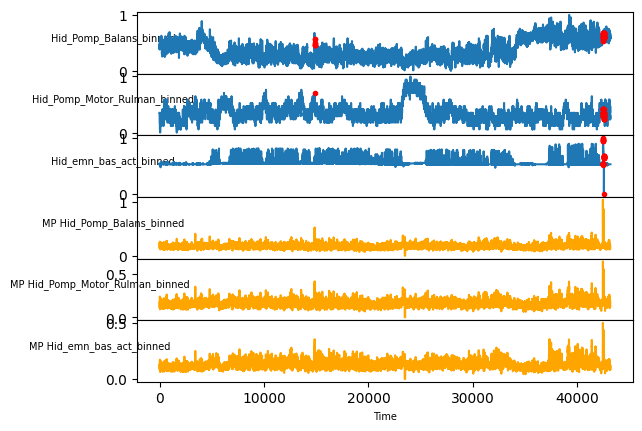

Hid_emn_bas_act_binned
10 ANOMALIES


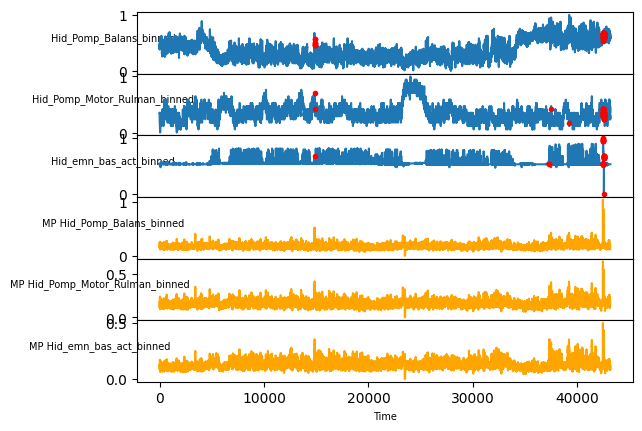

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


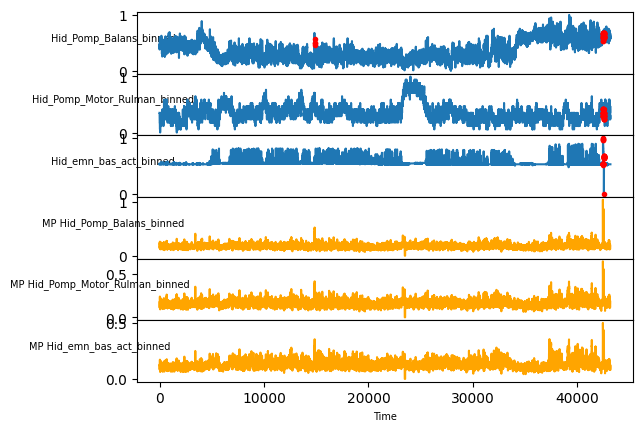

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


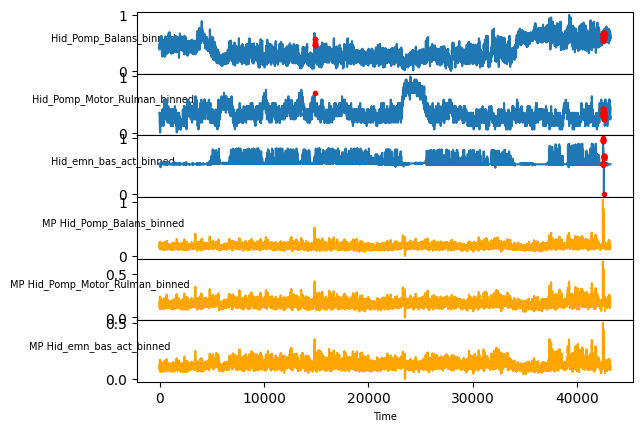

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


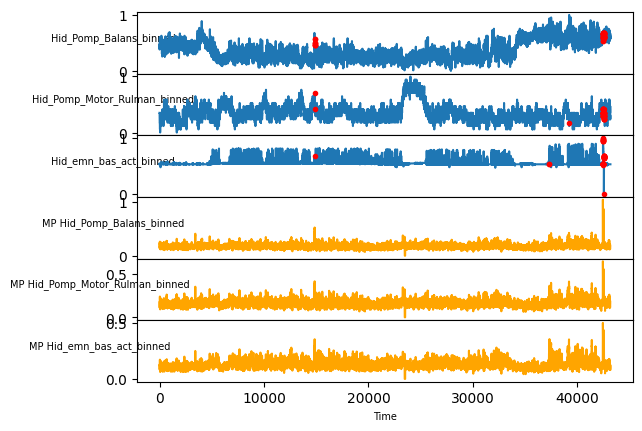

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


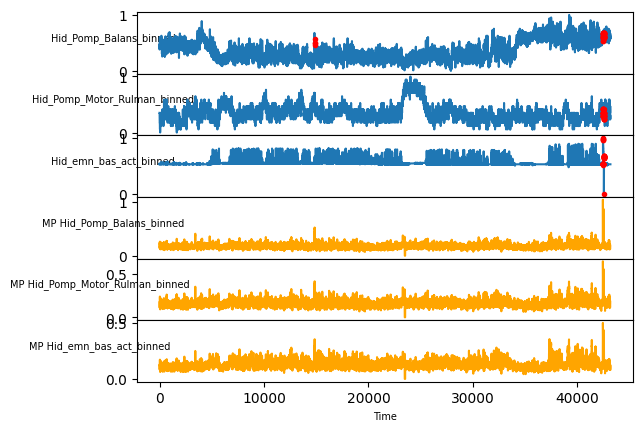

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


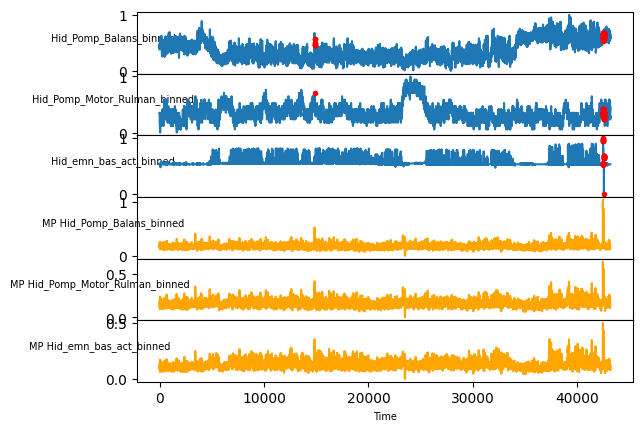

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


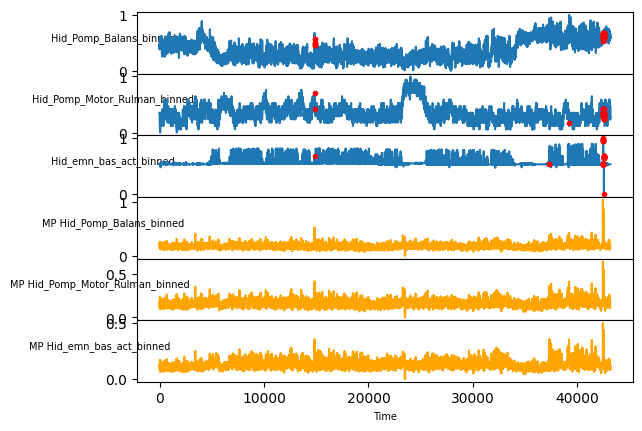

Hid_emn_bas_act_binned
1 ANOMALIES


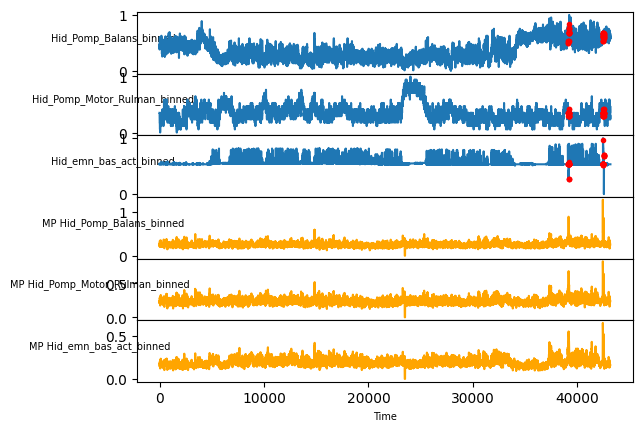

Hid_emn_bas_act_binned
5 ANOMALIES


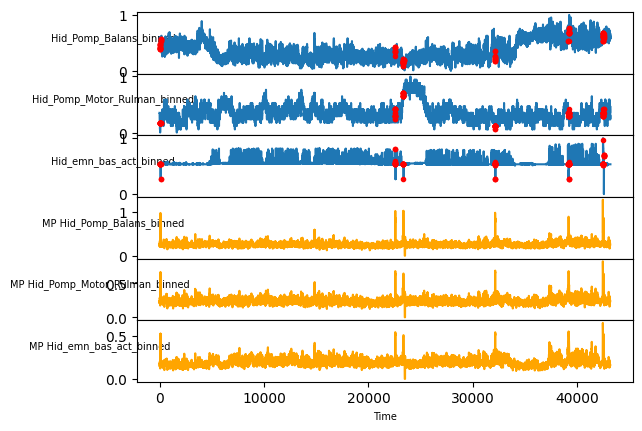

Hid_emn_bas_act_binned
10 ANOMALIES


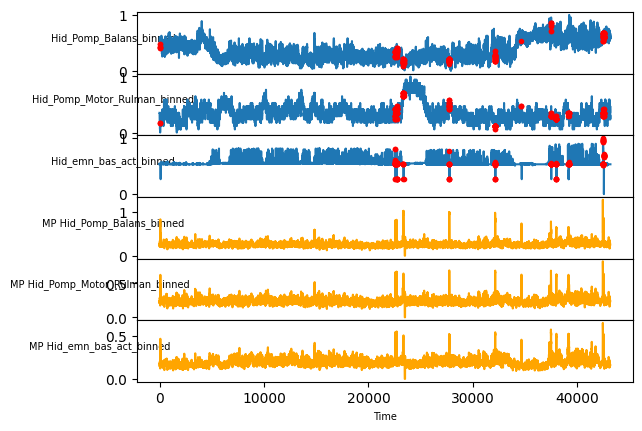

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


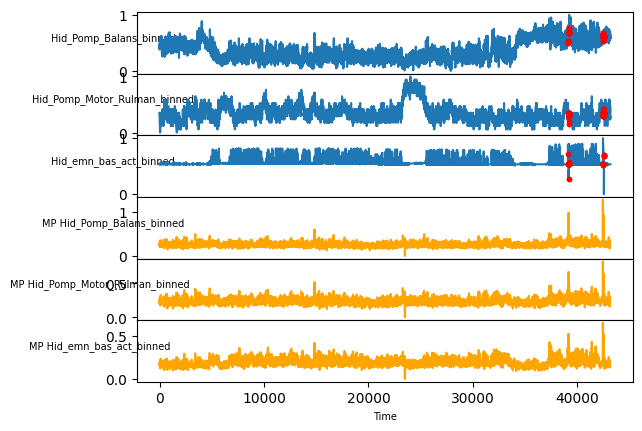

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


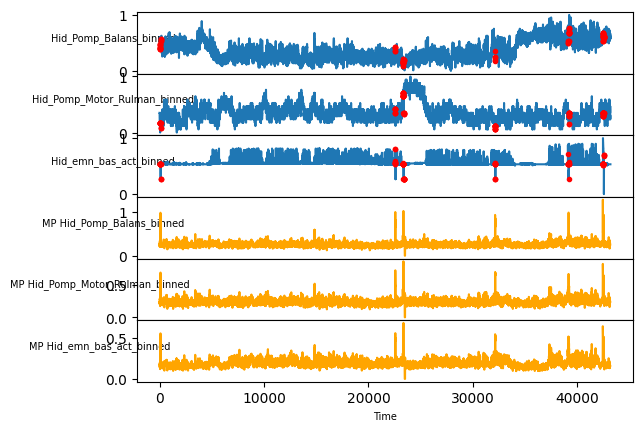

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


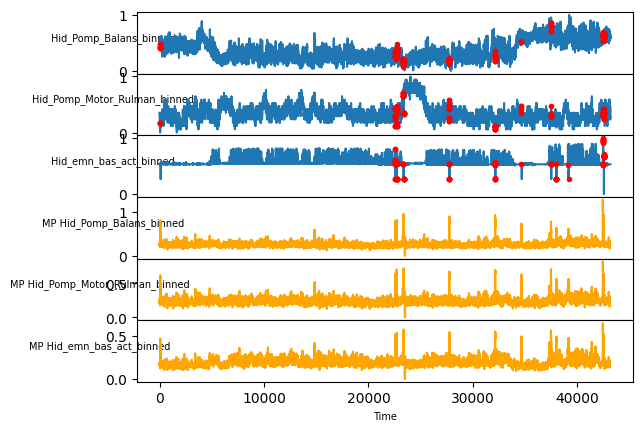

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


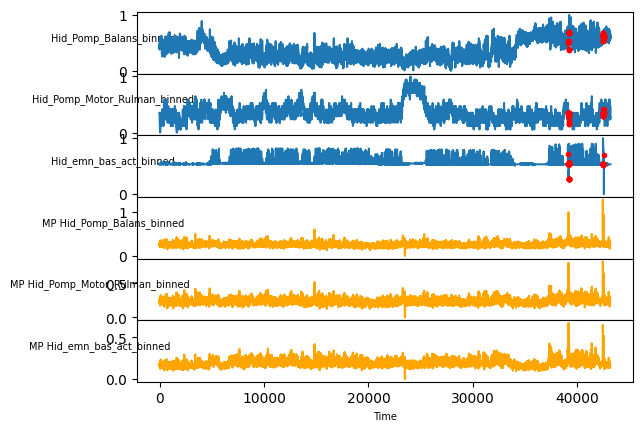

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


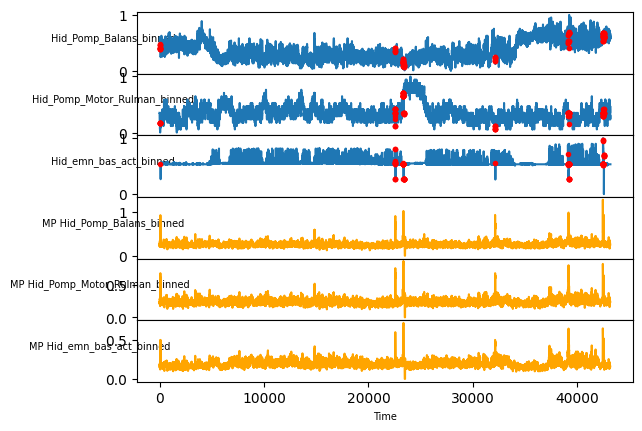

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


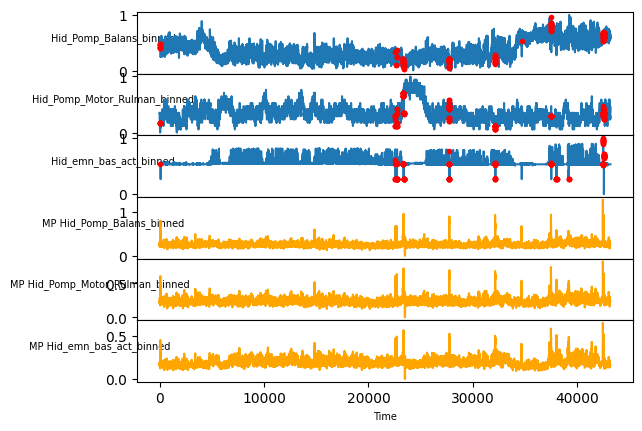

Hid_emn_bas_act_binned
1 ANOMALIES


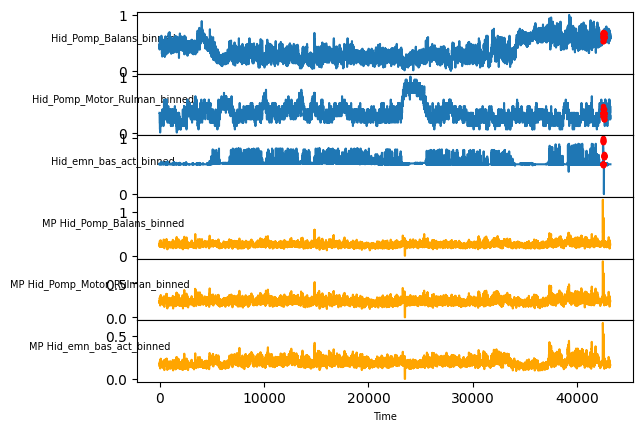

Hid_emn_bas_act_binned
5 ANOMALIES


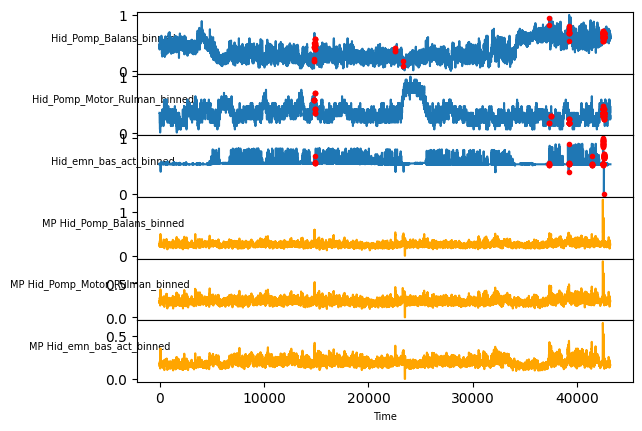

Hid_emn_bas_act_binned
10 ANOMALIES


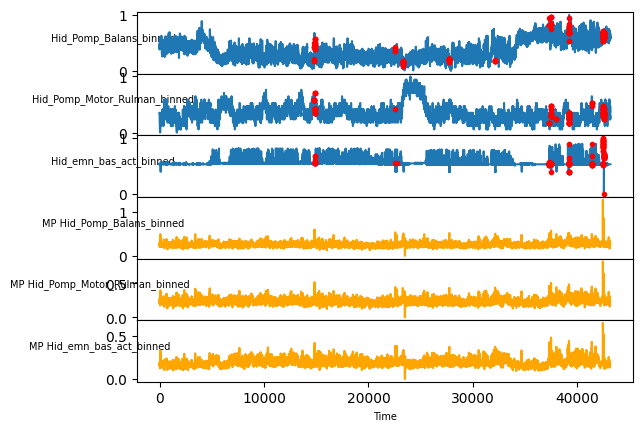

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


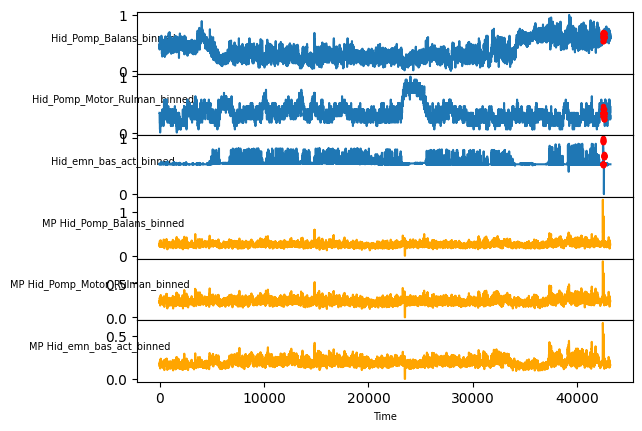

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


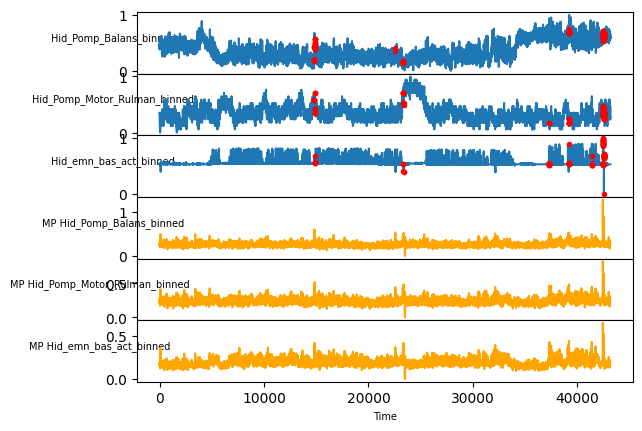

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


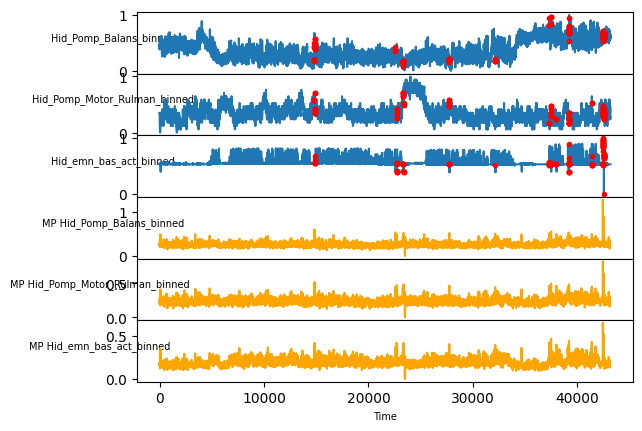

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


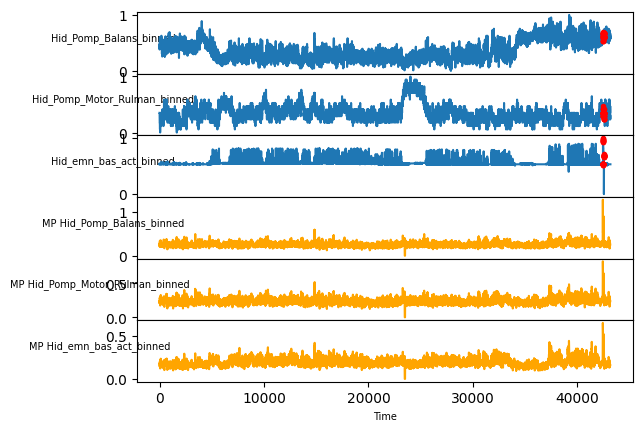

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


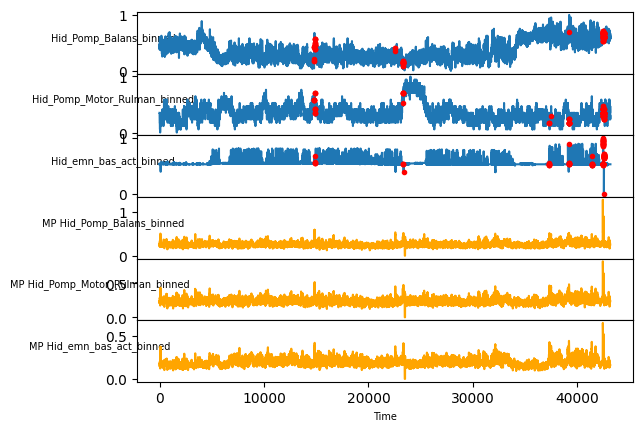

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


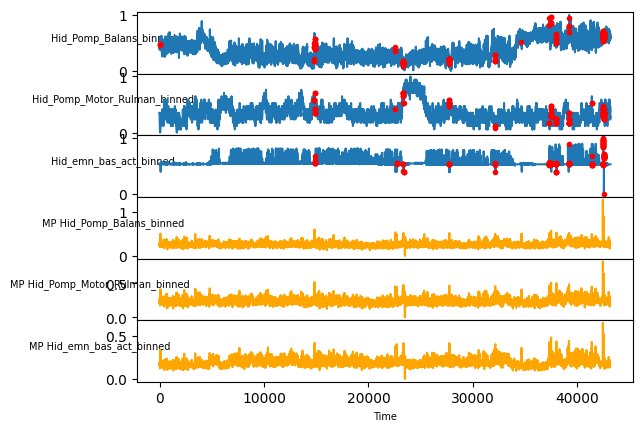

Hid_emn_bas_act_binned
1 ANOMALIES


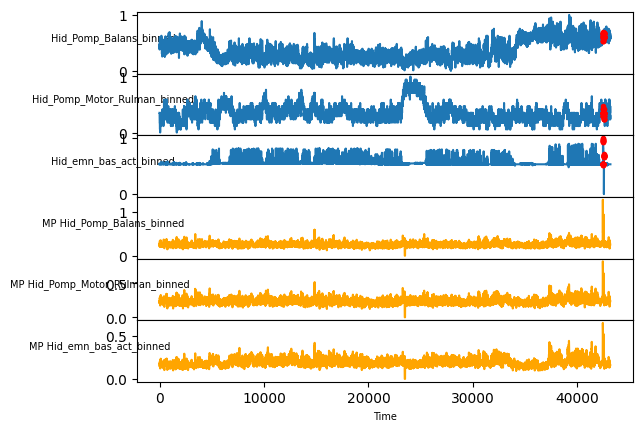

Hid_emn_bas_act_binned
5 ANOMALIES


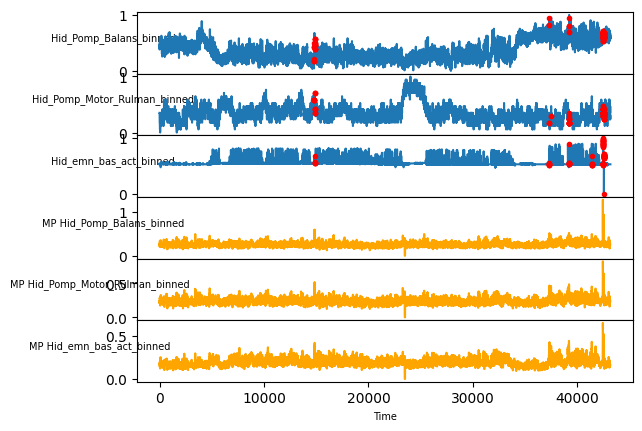

Hid_emn_bas_act_binned
10 ANOMALIES


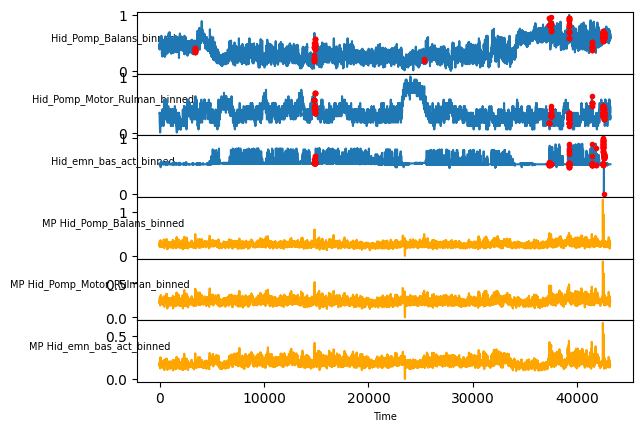

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


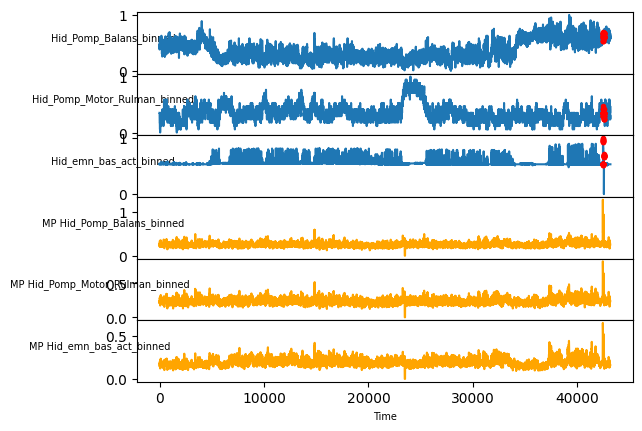

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


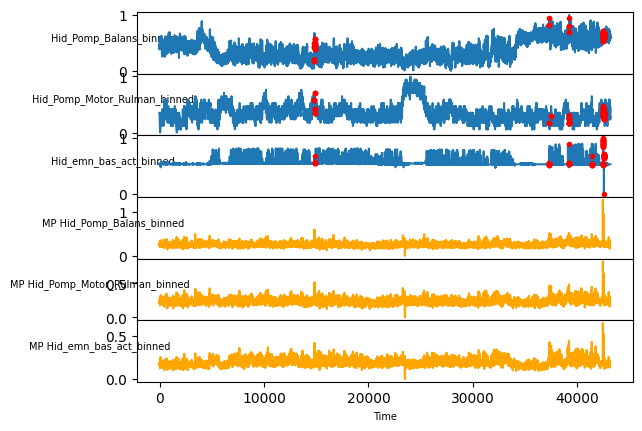

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


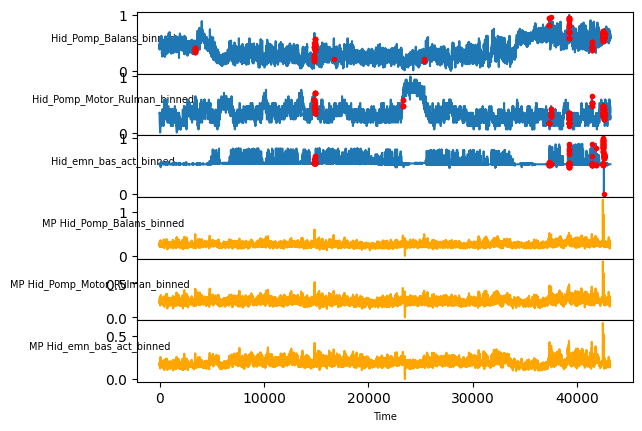

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


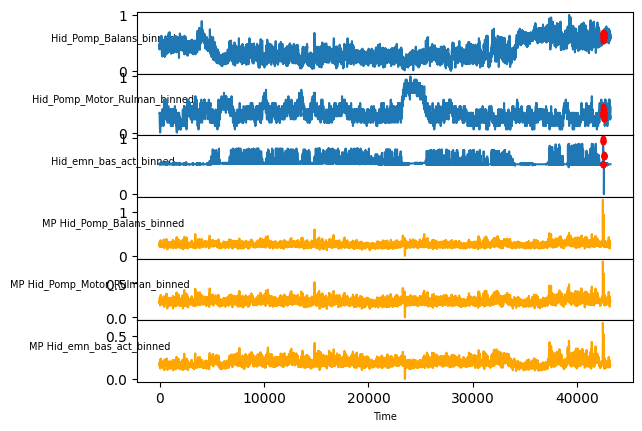

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


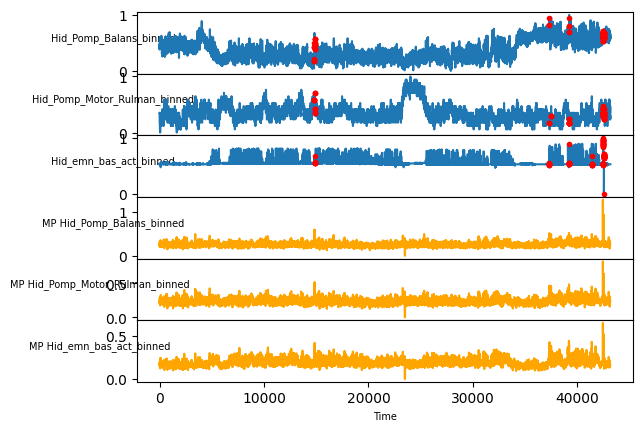

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


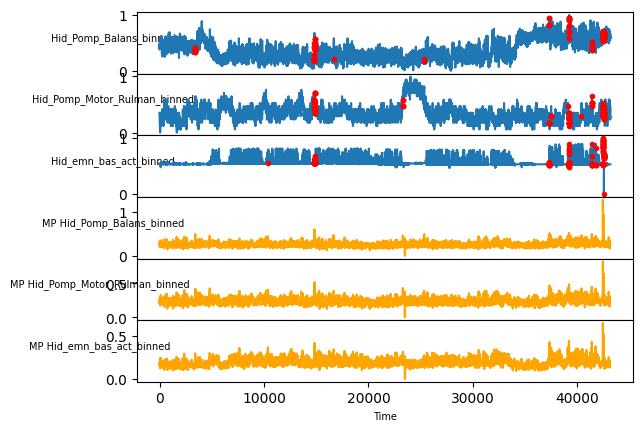

Hid_emn_bas_act_binned
1 ANOMALIES


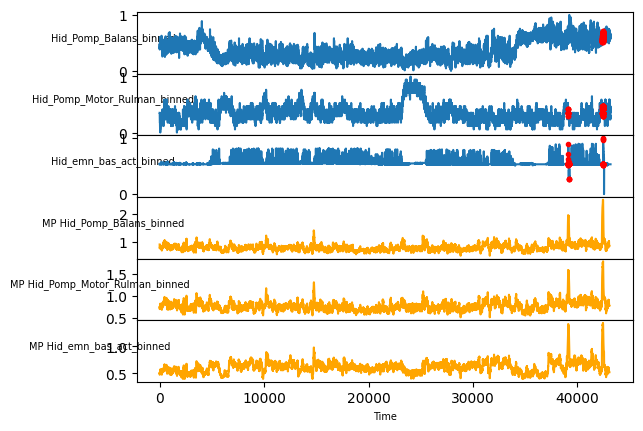

Hid_emn_bas_act_binned
5 ANOMALIES


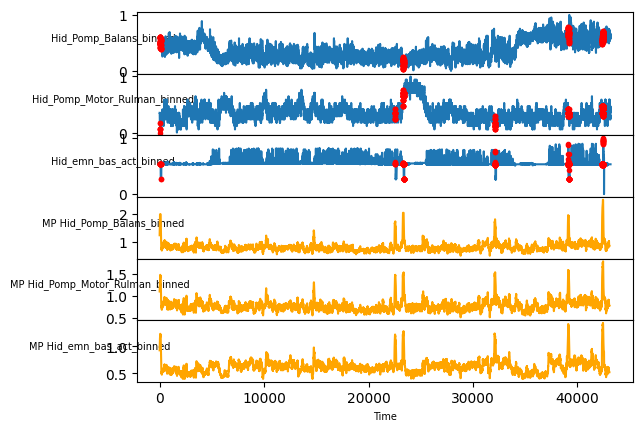

Hid_emn_bas_act_binned
10 ANOMALIES


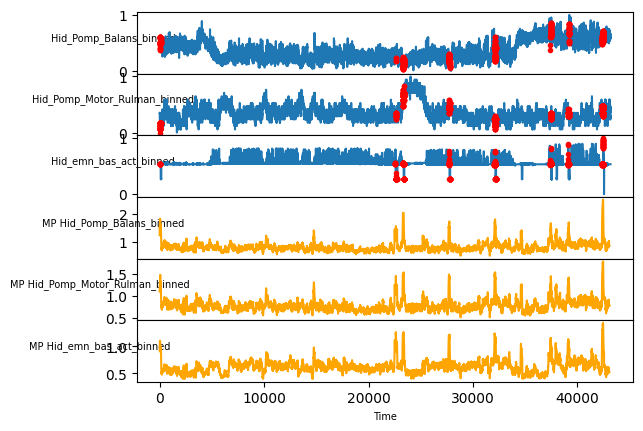

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


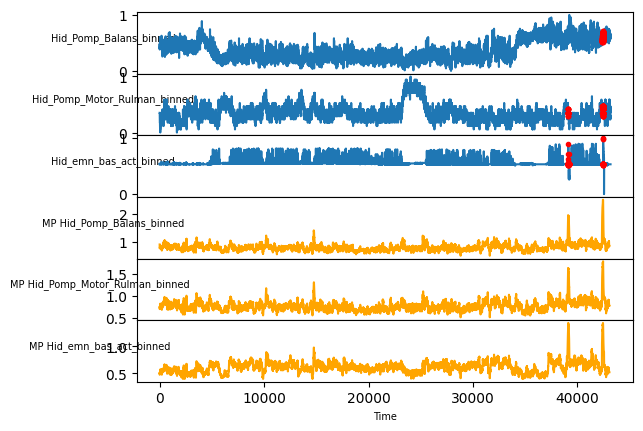

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


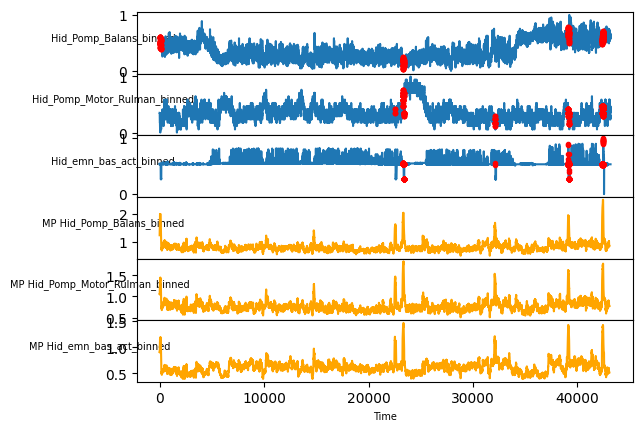

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


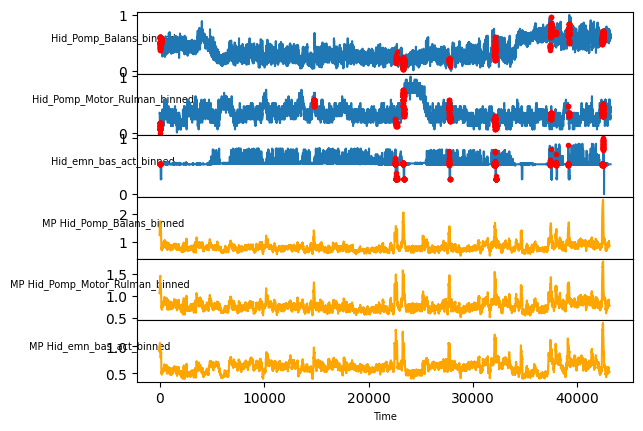

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


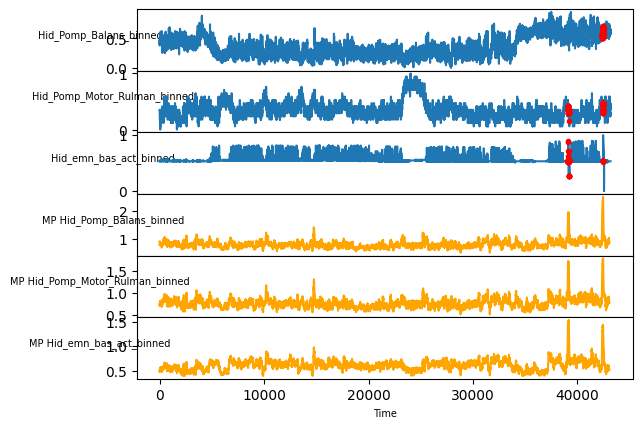

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


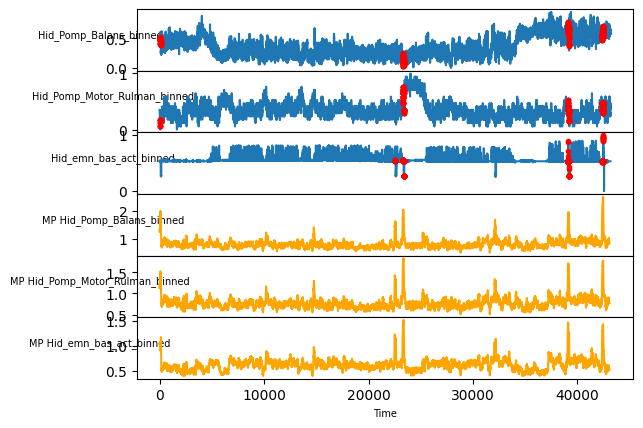

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


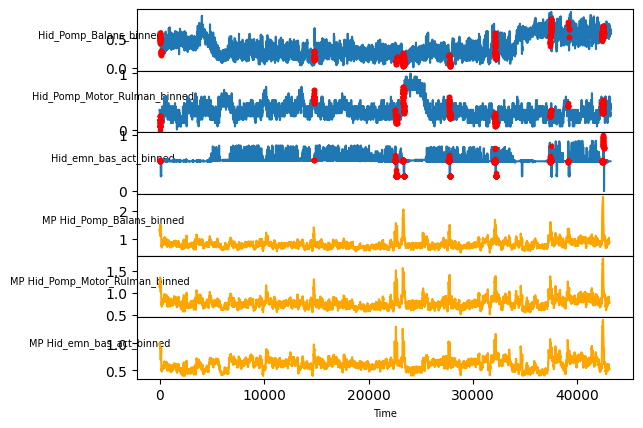

Hid_emn_bas_act_binned
1 ANOMALIES


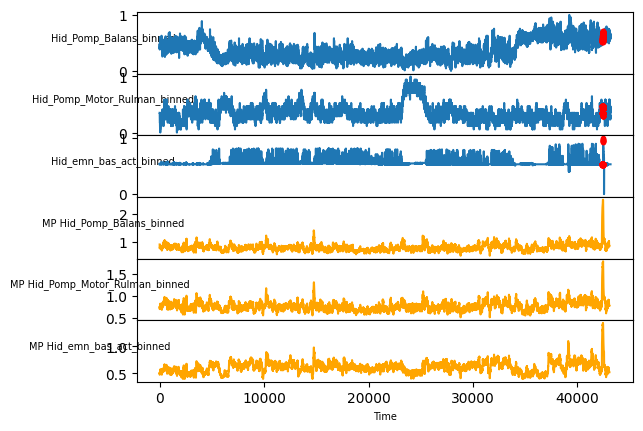

Hid_emn_bas_act_binned
5 ANOMALIES


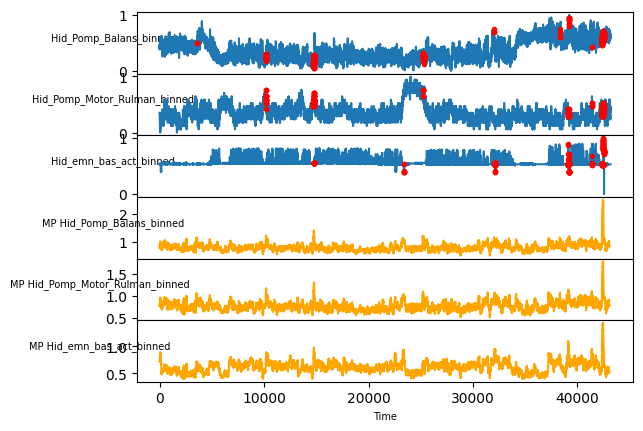

Hid_emn_bas_act_binned
10 ANOMALIES


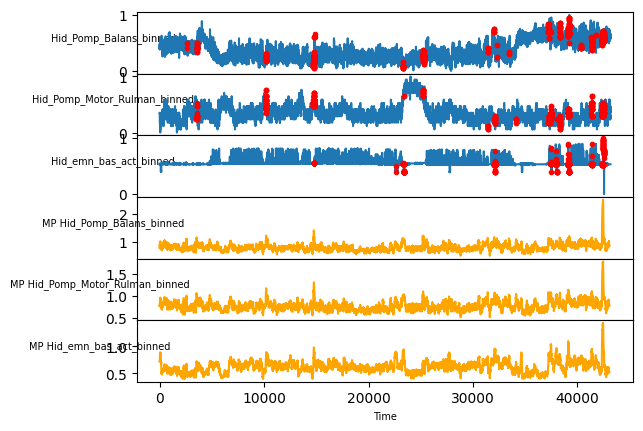

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


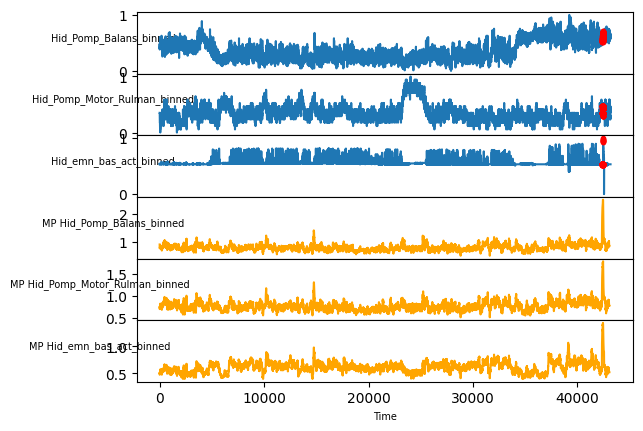

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


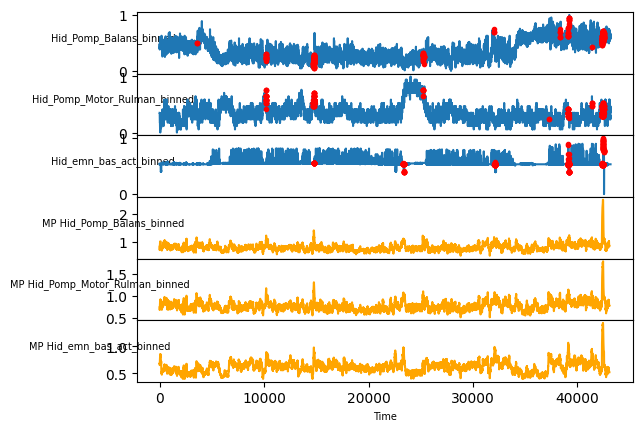

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


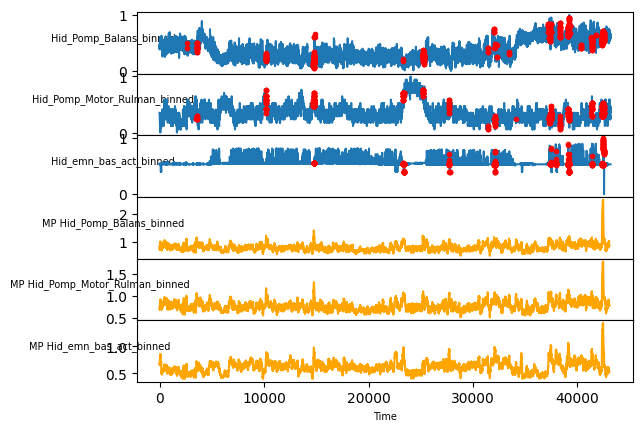

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


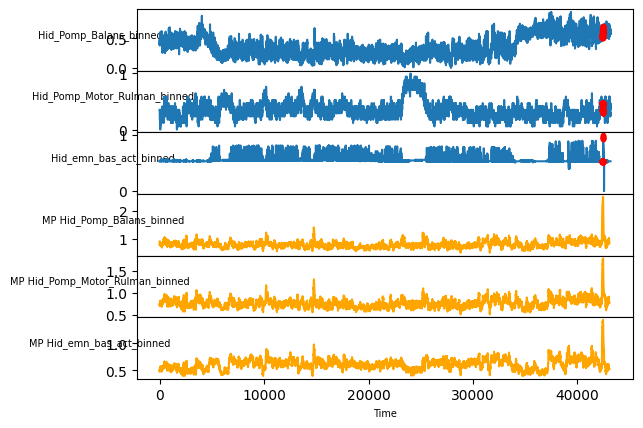

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


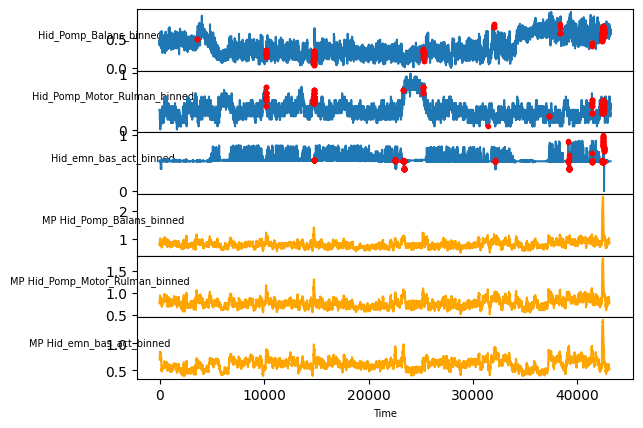

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


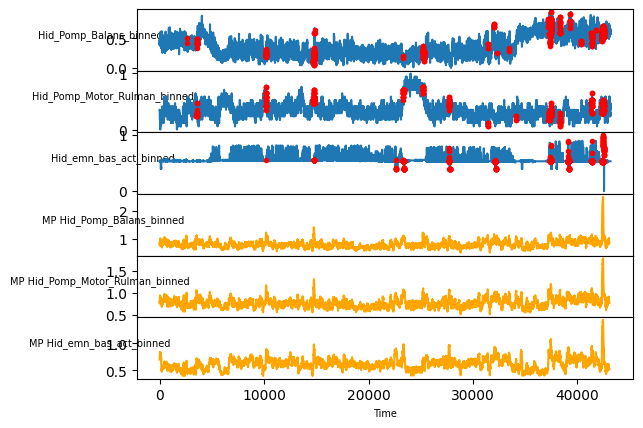

Hid_emn_bas_act_binned
1 ANOMALIES


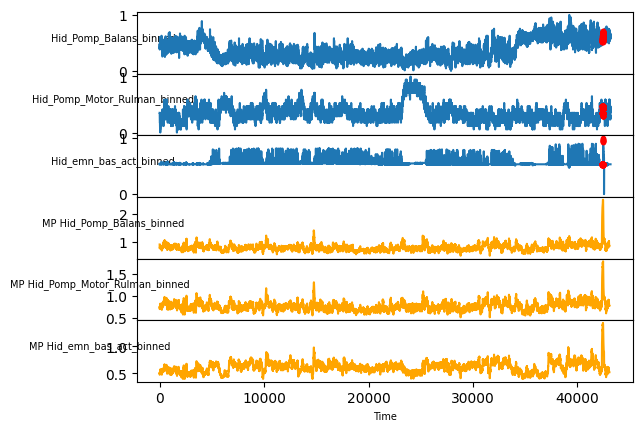

Hid_emn_bas_act_binned
5 ANOMALIES


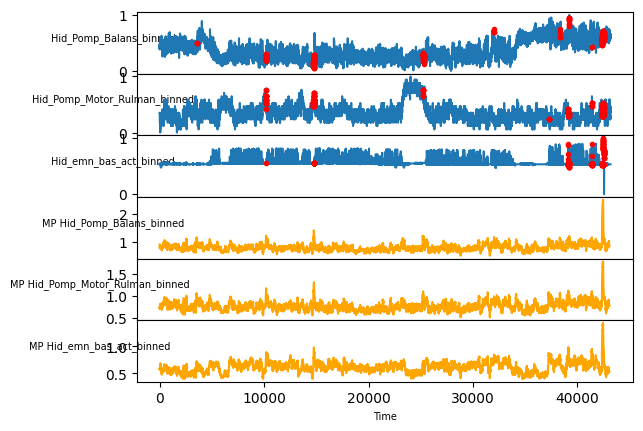

Hid_emn_bas_act_binned
10 ANOMALIES


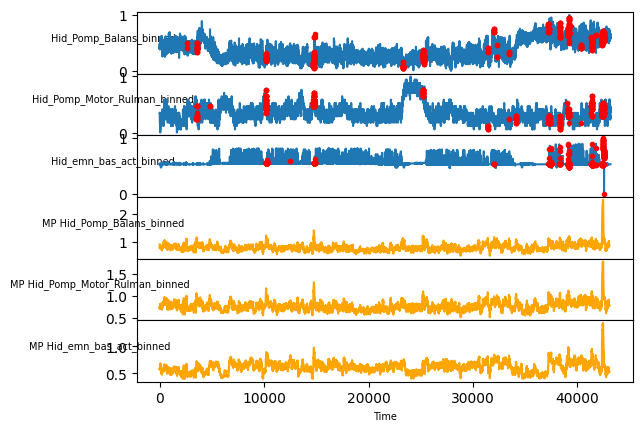

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES


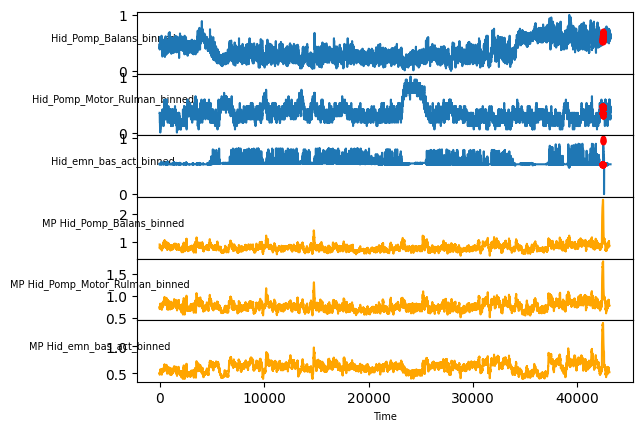

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


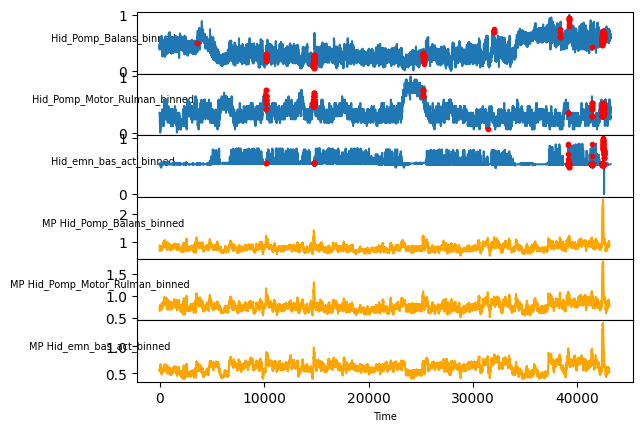

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES


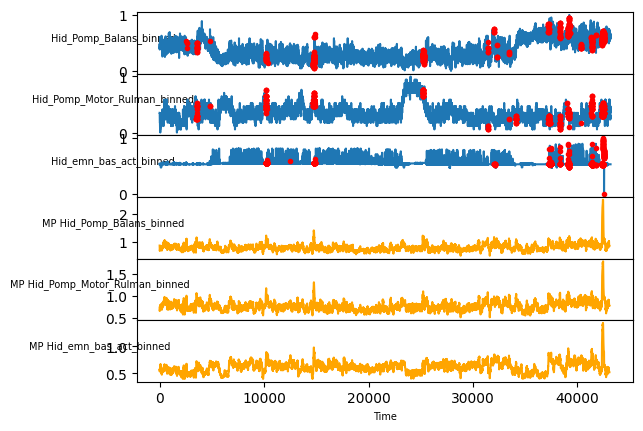

Hid_emn_bas_act_binned
1 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
1 ANOMALIES
Hid_Pomp_Balans_binned
1 ANOMALIES


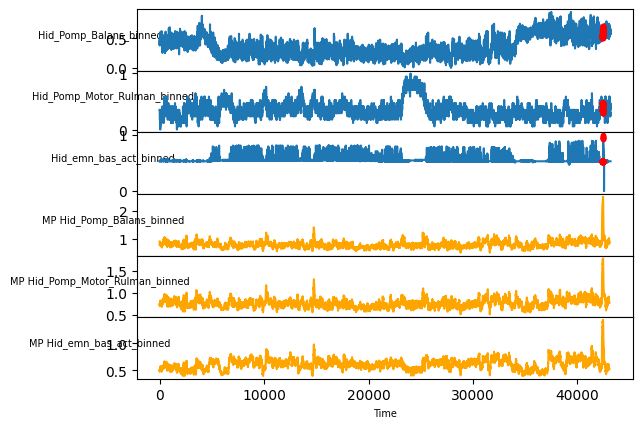

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


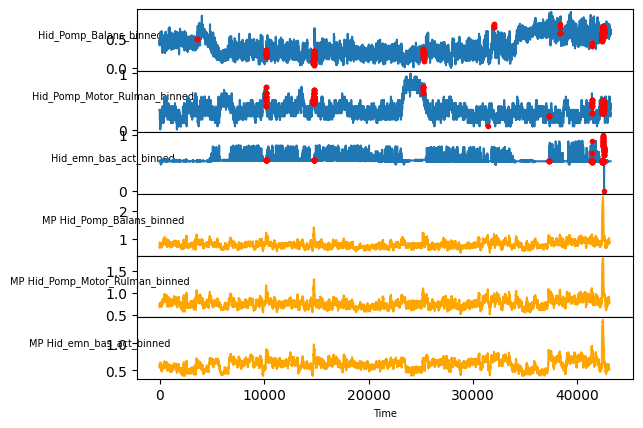

Hid_emn_bas_act_binned
10 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
10 ANOMALIES
Hid_Pomp_Balans_binned
10 ANOMALIES


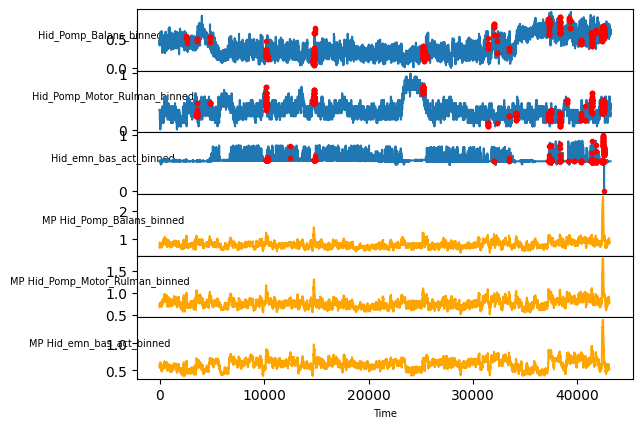

In [17]:
for wave_length in wave_lengths:
    for noise in noises:
        for sensors in nsensors:
            for anomaly_count in anomaly_counts:
                anomaly_normal_ratio = anomaly_normal_ratios[anomaly_count]
                df_results = get_results(df1, anomaly_normal_ratio, anomaly_count, wave_length, noise, sensors, df_results)
            

Hid_emn_bas_act_binned
5 ANOMALIES


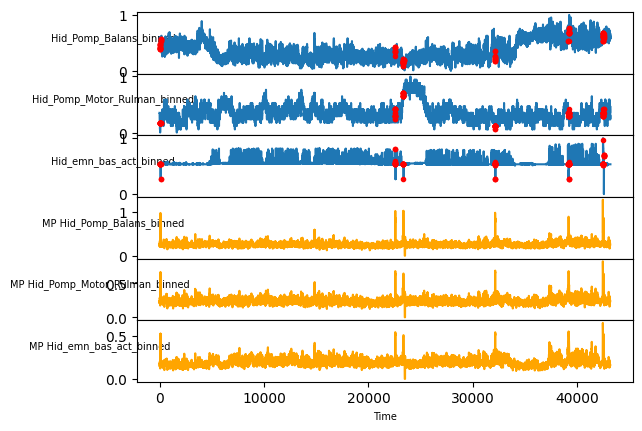

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


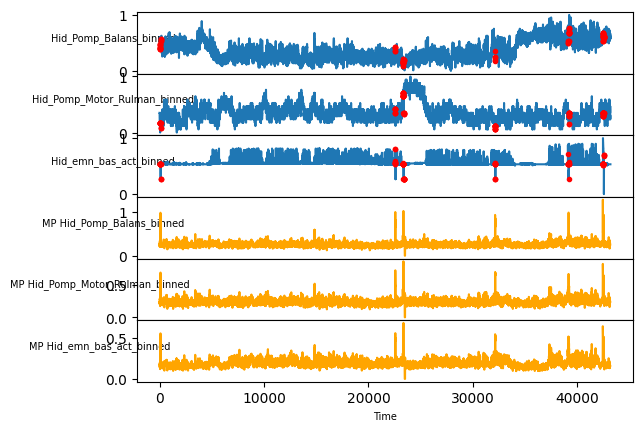

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


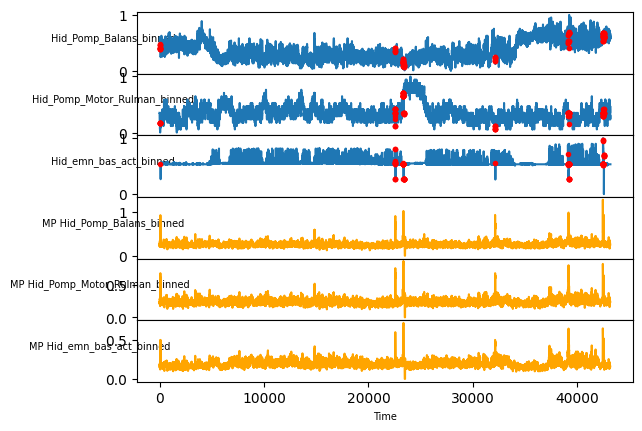

Hid_emn_bas_act_binned
5 ANOMALIES


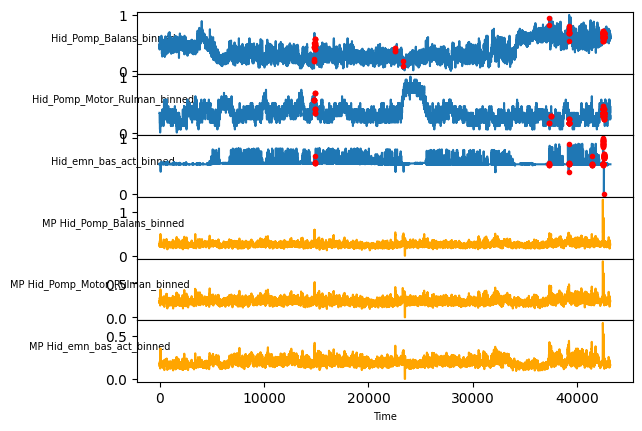

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


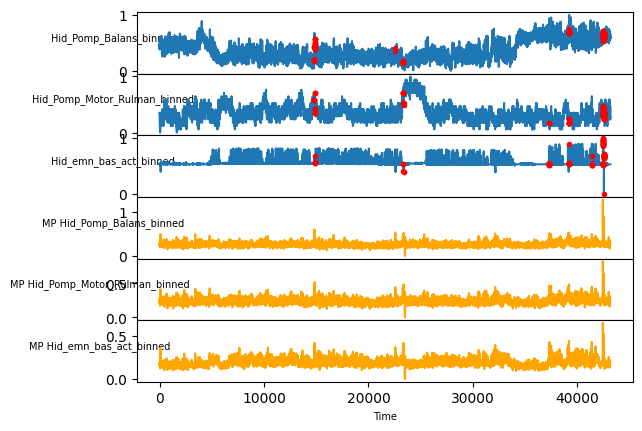

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


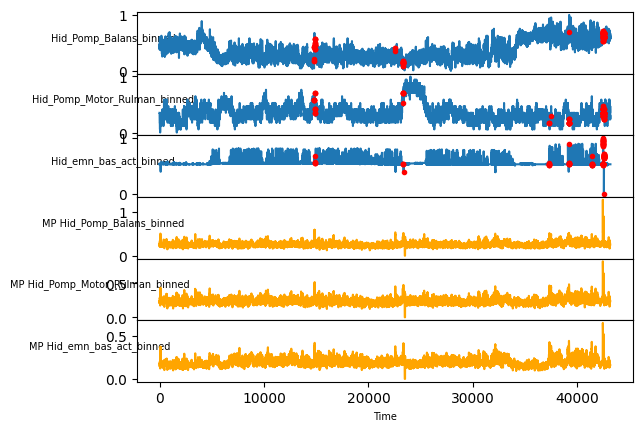

Hid_emn_bas_act_binned
5 ANOMALIES


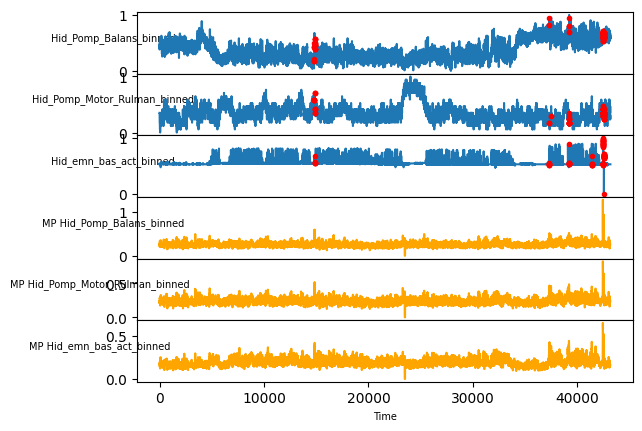

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES


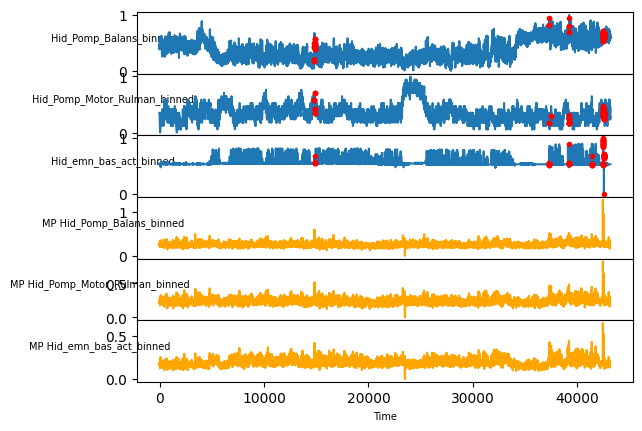

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


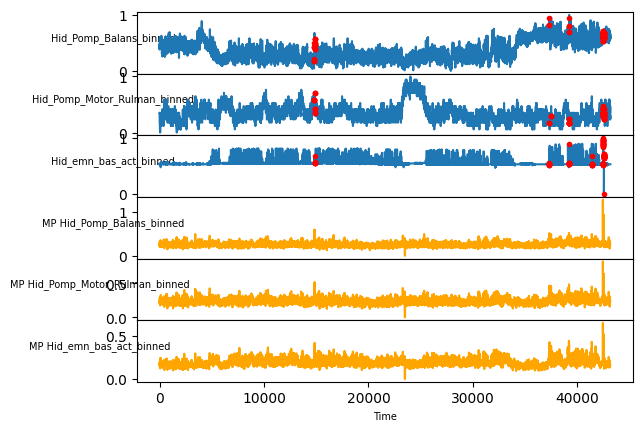

In [38]:
# for noise in noises:
#         for sensors in nsensors:
#                 df_results = get_results(df1, 0.00013, 5, 15, noise, sensors, df_results)
            

In [39]:
df_results

,data,noise,nsensors,anomaly count,wave len,window,precision,recall,anomaly_normal_ratio,noise direction
0,77,0.50,1,5,15,30,1.000000,1.000000,0.00013,n
1,77,0.50,2,5,15,30,1.000000,1.000000,0.00013,n
2,77,0.50,3,5,15,30,1.000000,1.000000,0.00013,n
3,77,0.25,1,5,15,30,0.739130,0.739130,0.00013,n
4,77,0.25,2,5,15,30,0.739130,0.739130,0.00013,n
5,77,0.25,3,5,15,30,0.739130,0.739130,0.00013,n
6,77,0.10,1,5,15,30,0.478261,0.478261,0.00013,n
7,77,0.10,2,5,15,30,0.478261,0.478261,0.00013,n
8,77,0.10,3,5,15,30,0.478261,0.478261,0.00013,n


In [18]:
df_results.to_csv("mp_multi_res_final666.csv", index = False)

In [31]:
df_results

,data,noise,nsensors,anomaly count,wave len,window,precision,recall,anomaly_normal_ratio,noise direction
0,77,0.5,1,1,1,20,0.975610,0.975610,0.000025,n
1,77,0.5,1,5,1,20,0.888889,0.888889,0.000130,n
2,77,0.5,1,10,1,20,0.800000,0.800000,0.000240,n
3,77,0.5,2,1,1,20,0.975610,0.975610,0.000025,n
4,77,0.5,2,5,1,20,0.888889,0.888889,0.000130,n
...,...,...,...,...,...,...,...,...,...,...
76,77,0.1,2,5,60,120,0.294118,0.294118,0.000130,n
77,77,0.1,2,10,60,120,0.437500,0.437500,0.000240,n
78,77,0.1,3,1,60,120,0.400000,0.400000,0.000025,n
79,77,0.1,3,5,60,120,0.294118,0.294118,0.000130,n


Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


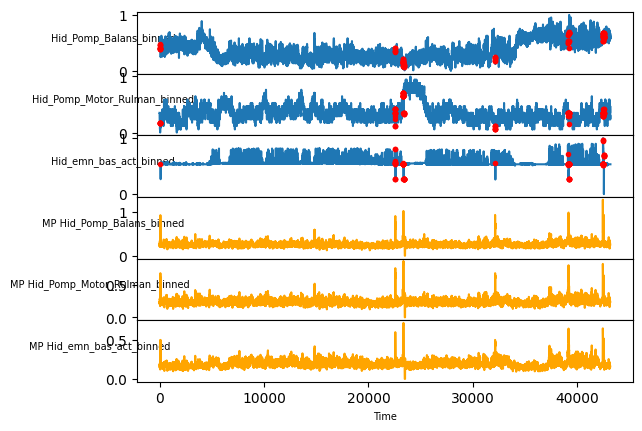

,data,noise,nsensors,anomaly count,wave len,window,precision,recall,anomaly_normal_ratio,noise direction
0,77,0.5,3,5,15,30,1.0,1.0,0.00013,n


In [35]:
# get_results(df1, 0.00013, 5, 15, 0.5, 3,  df_results)

In [30]:
# aa = get_results(df1, 0.00013, 5, 15, 0.5, 3,  df_results)

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES
3
115


#### Test

Hid_emn_bas_act_binned
5 ANOMALIES
Hid_Pomp_Motor_Rulman_binned
5 ANOMALIES
Hid_Pomp_Balans_binned
5 ANOMALIES


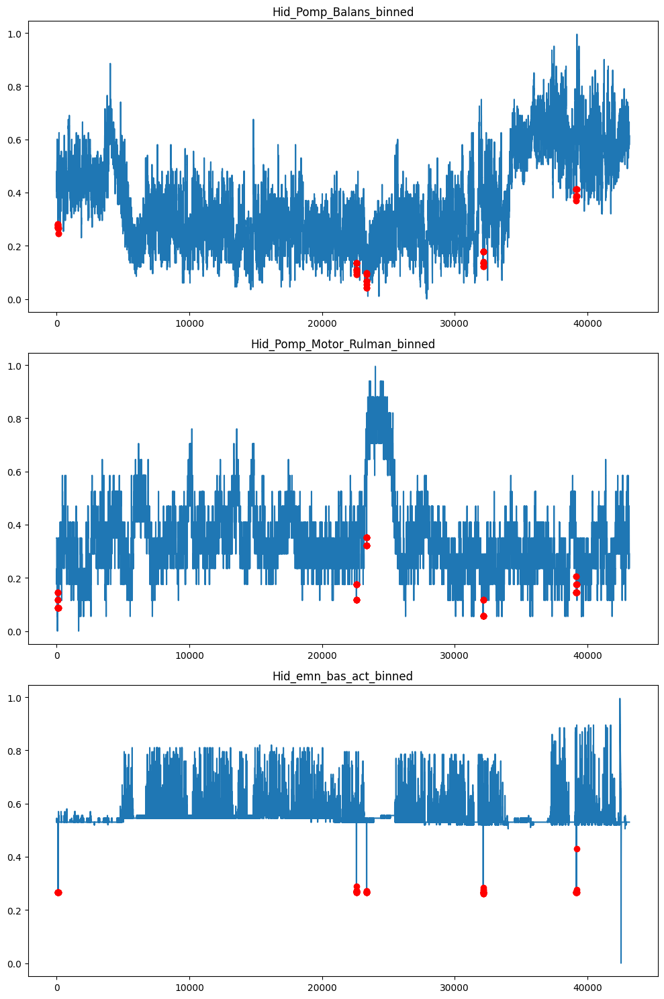

In [23]:
df2 = df1.copy()
df2, anomaly_points2 = lib.preprocess.anomaly.apply_anomaly(df2, noise = 0.5, anomaly_normal_ratio = 0.00013, noise_direction = 'n', random_state = 300, wave = True, wave_length = 15, nsensors = 3)
lib.preprocess.anomaly.plot_anomaly(df2, anomaly_points2)

anomaly_points2['Hid_emn_bas_act_binned'].append([42549, 42548, 42441, 42457, 42547, 42442, 42456, 42527, 42443,
                                42546, 42455, 42545, 42444, 42544, 42528, 42543, 42542, 42541,
                                42540, 42539, 42538, 42529, 42537, 42536, 42454, 42535, 42530,
                                42534, 42445, 42533, 42531, 42532, 42453, 42446, 42452, 42451,
                                42447, 42450, 42449, 42448])

In [12]:
m = 30
mps2, indices2 = stumpy.mstump(df2[df2.columns[1:]], m, normalize = False, discords = True)

In [65]:
anomaly_points2 = anomaly_points2[next(iter(anomaly_points2))]
b = sum(len(arr) for arr in anomaly_points2)
discords2 = np.argpartition(mps2, -int(b), axis=1)[:, -int(b):]

In [25]:
anomaly_points2

[[39170,
  39171,
  39172,
  39173,
  39174,
  39175,
  39176,
  39177,
  39178,
  39179,
  39180,
  39181,
  39182,
  39183,
  39184],
 [23359,
  23360,
  23361,
  23362,
  23363,
  23364,
  23365,
  23366,
  23367,
  23368,
  23369,
  23370,
  23371,
  23372,
  23373],
 [22590,
  22591,
  22592,
  22593,
  22594,
  22595,
  22596,
  22597,
  22598,
  22599,
  22600,
  22601,
  22602,
  22603,
  22604],
 [97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111],
 [32146,
  32147,
  32148,
  32149,
  32150,
  32151,
  32152,
  32153,
  32154,
  32155,
  32156,
  32157,
  32158,
  32159,
  32160],
 [42549,
  42548,
  42441,
  42457,
  42547,
  42442,
  42456,
  42527,
  42443,
  42546,
  42455,
  42545,
  42444,
  42544,
  42528,
  42543,
  42542,
  42541,
  42540,
  42539,
  42538,
  42529,
  42537,
  42536,
  42454,
  42535,
  42530,
  42534,
  42445,
  42533,
  42531,
  42532,
  42453,
  42446,
  42452,
  42451,
  42447,
  42450,
  42449,
  42448]]

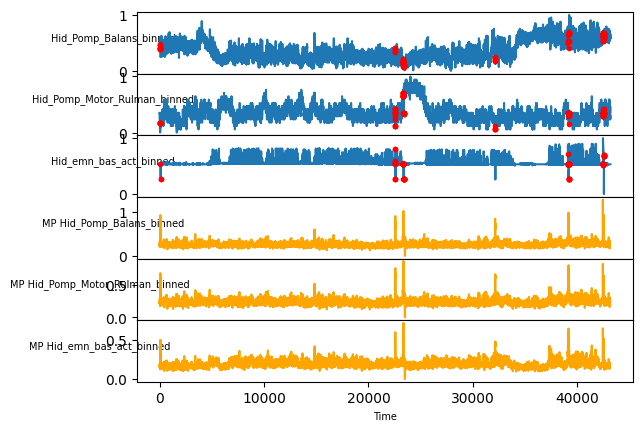

In [67]:
fig, axs = plt.subplots(mps2.shape[0] * 2, sharex=True, gridspec_kw={'hspace': 0})

for k, dim_name in enumerate(df2.columns[1:]):
    axs[k].set_ylabel(dim_name, fontsize='7', rotation = 0)
    axs[k].plot(df2[dim_name])
    axs[k].set_xlabel('Time', fontsize ='7')

    for idx in discords2[k]:
        axs[k].plot(idx, df2[dim_name].iloc[idx], 'ro', markersize=3) 

    axs[k + mps2.shape[0]].set_ylabel("MP {}".format(dim_name), fontsize='7', rotation = 0)
    axs[k + mps2.shape[0]].plot(mps2[k], c='orange')
    axs[k + mps2.shape[0]].set_xlabel('Time', fontsize ='7')

   
plt.show()

In [79]:
get_metrics_multi(anomaly_points2, discords2, m)

(1.0, 1.0)